# Project

![](banner_project.jpg)

In [1]:
analyst = "Bon Hee Koo" # Replace this with your name

In [2]:
f = "setup.R"; for (i in 1:10) { if (file.exists(f)) break else f = paste0("../", f) }; source(f)
options(repr.matrix.max.rows=674)
options(repr.matrix.max.cols=200)
update_geom_defaults("point", list(size=1))                                

.................................................... start of document ....................................................

## Directions

### Objective

Recommend a portfolio of 12 company investments that maximizes 12-month return of an overall $1,000,000 investment made at the end of quarter 4 of year 2018.

### Approach

* Explore company fundamentals data for thousands of companies from quarters 1, 2, 3, and 4 of year 2017 + company stock price data for those companies from quarter 4 of year 2018.


* Explore various ways of representing the data, using variable selection, principal component analysis, cluster analysis, and other methods.


* Construct models to predict 12-month stock price growth given 12 months of past company fundamentals data, using various machine learning model construction methods.


* Develop criteria to choose company investment levels informed by the models, and estimate the models' business performance.


* Tune the models for optimal performance and select the best one.


* Use the best model applied to company fundamentals data for a set of investment opportunities for quarters 1, 2, 3, and 4 of year 2018, and accordingly recommend a portfolio of 12 company investments.

### Data

**Datasets:**<br>
Datasets comprise a list of company investment opportunities, a data dictionary, and company fundamentals for select US active, publicly held companies that reported quarterly measures including stock prices for 1st, 2nd, 3rd, and 4th quarters in years 2017 and 2018.  All non-missing stock prices exceed $3 per share.  File formats are all comma-separated values (CSV).

* Data Dictionary.csv
* Company Fundamentals 2017.csv
* Company Fundamentals 2018.csv
* Investment Opportunities.csv


**Data Source:**<br>
Wharton Research Data Services > Compustat - Capital IQ from Standard & Poor's > North America - Daily > Fundamentals Quarterly (https://wrds-www.wharton.upenn.edu/)

* Date Variable: Data Date
* Date Range: 2017-01 to 2017-12 -or- 2018-01 to 2018-12
* Company Codes: Search the entire database
  * Consolidtaion Level: C, Output
  * Industry Format: INDL, FS, Output
  * Data Format: STD, Output
  * Population Source: D, Output
  * Quarter Type: Fiscal View, Output
  * Currency: USD, Output (not CAD)
  * Company Status: Active, Output (not Inactive)
* Variable Types: Data Items, Select All (674)
* Query output:
  * Output format: comma-delimited text
  * Compression type: None
  * Data format: MMDDYY10
  
  
* For Data Dictionary: Variable Descriptions tab, copy to excel, save as csv


## Business Model

Business model is ...

$$ \begin{align} profit = \left( \sum_{i \in portfolio} (1 + growth_i) \times allocation_i \right) - budget \end{align} $$

<br>

$$ profit\,rate = profit \div budget $$


$$ \begin{align} budget = \sum_{i \in portfolio} allocation_i \end{align} $$


Business model parameters include ...

* Budget = \$1,000,000: total investment to allocate across the companies in the portfolio
* Portfolio Size = 12: number of companies in the portfolio
* Threshold = 30\%: amount of growth required to qualify as big growth, $\geq 0$

In [3]:
# Set the business parameters.
budget = 1000000
portfolio_size = 12
Threshold = 0.3

## Data Retrieval

_<< Discuss this data retrieval. >>_

### Data Dictionary

Retrieve and present the data dictionary for the company fundamentals data.

In [4]:
# Retrieve the data dictionary.
dictionary= read.csv("Data Dictionary.csv")
dictionary
nrow(dictionary)

Variable.Name,Data.Type,Variable.Description,Help
ACCHGQ,NUM,ACCHGQ -- Accounting Changes - Cumulative Effect,NA
ACCHGY,NUM,ACCHGY -- Accounting Changes - Cumulative Effect,NA
ACCTCHGQ,CHAR,ACCTCHGQ -- Adoption of Accounting Changes,NA
ACCTSTDQ,CHAR,ACCTSTDQ -- Accounting Standard,NA
ACOMINCQ,NUM,ACOMINCQ -- Accumulated Other Comprehensive Income (Loss),NA
ACOQ,NUM,ACOQ -- Current Assets - Other - Total,NA
ACTQ,NUM,ACTQ -- Current Assets - Total,NA
ADD1,CHAR,ADD1 -- Address Line 1,NA
ADD2,CHAR,ADD2 -- Address Line 2,NA
ADD3,CHAR,ADD3 -- Address Line 3,NA


[1] 674

### Data for 2017

#### Retrieve Raw Data

Retrieve the company fundamentals data for calendar year 2017.  This dataset is intended use as the training and validation predictor variables.

In [5]:
# Retrieve the 2017 data.
CF2017 = read.csv("Company Fundamentals 2017.csv")
nrow(CF2017)
ncol(CF2017)
colnames(CF2017)


[1] 33269

[1] 680

[1] "gvkey"      "datadate"   "fyearq"     "fqtr"       "fyr"       
  [6] "indfmt"     "consol"     "popsrc"     "datafmt"    "tic"       
 [11] "cusip"      "conm"       "acctchgq"   "acctstdq"   "adrrq"     
 [16] "ajexq"      "ajpq"       "bsprq"      "compstq"    "curcdq"    
 [21] "curncdq"    "currtrq"    "curuscnq"   "datacqtr"   "datafqtr"  
 [26] "finalq"     "ogmq"       "rp"         "scfq"       "srcq"      
 [31] "staltq"     "updq"       "apdedateq"  "fdateq"     "pdateq"    
 [36] "rdq"        "acchgq"     "acomincq"   "acoq"       "actq"      
 [41] "altoq"      "ancq"       "anoq"       "aociderglq" "aociotherq"
 [46] "aocipenq"   "aocisecglq" "aol2q"      "aoq"        "apq"       
 [51] "aqaq"       "aqdq"       "aqepsq"     "aqpl1q"     "aqpq"      
 [56] "arcedq"     "arceepsq"   "arceq"      "atq"        "aul3q"     
 [61] "billexceq"  "capr1q"     "capr2q"     "capr3q"     "capsftq"   
 [66] "capsq"      "ceiexbillq" "ceqq"       "cheq"       "chq"       
 [71] "cibegniq"   "cicurrq"    "ciderglq"   "cimiiq"     "ciotherq"  
 [76] "cipenq"     "ciq"        "cisecglq"   "citotalq"   "cogsq"     
 [81] "csh12q"     "cshfd12"    "cshfdq"     "cshiq"      "cshopq"    
 [86] "cshoq"      "cshprq"     "cstkcvq"    "cstkeq"     "cstkq"     
 [91] "dcomq"      "dd1q"       "deracq"     "deraltq"    "derhedglq" 
 [96] "derlcq"     "derlltq"    "diladq"     "dilavq"     "dlcq"      
[101] "dlttq"      "doq"        "dpacreq"    "dpactq"     "dpq"       
[106] "dpretq"     "drcq"       "drltq"      "dteaq"      "dtedq"     
[111] "dteepsq"    "dtepq"      "dvintfq"    "dvpq"       "epsf12"    
[116] "epsfi12"    "epsfiq"     "epsfxq"     "epspi12"    "epspiq"    
[121] "epspxq"     "epsx12"     "esopctq"    "esopnrq"    "esoprq"    
[126] "esoptq"     "esubq"      "fcaq"       "ffoq"       "finacoq"   
[131] "finaoq"     "finchq"     "findlcq"    "findltq"    "finivstq"  
[136] "finlcoq"    "finltoq"    "finnpq"     "finreccq"   "finrecltq" 
[141] "finrevq"    "finxintq"   "finxoprq"   "gdwlamq"    "gdwlia12"  
[146] "gdwliaq"    "gdwlid12"   "gdwlidq"    "gdwlieps12" "gdwliepsq" 
[151] "gdwlipq"    "gdwlq"      "glaq"       "glcea12"    "glceaq"    
[156] "glced12"    "glcedq"     "glceeps12"  "glceepsq"   "glcepq"    
[161] "gldq"       "glepsq"     "glivq"      "glpq"       "hedgeglq"  
[166] "ibadj12"    "ibadjq"     "ibcomq"     "ibmiiq"     "ibq"       
[171] "icaptq"     "intaccq"    "intanoq"    "intanq"     "invfgq"    
[176] "invoq"      "invrmq"     "invtq"      "invwipq"    "ivaeqq"    
[181] "ivaoq"      "ivltq"      "ivstq"      "lcoq"       "lctq"      
[186] "lltq"       "lnoq"       "lol2q"      "loq"        "loxdrq"    
[191] "lqpl1q"     "lseq"       "ltmibq"     "ltq"        "lul3q"     
[196] "mibnq"      "mibq"       "mibtq"      "miiq"       "msaq"      
[201] "ncoq"       "niitq"      "nimq"       "niq"        "nopiq"     
[206] "npatq"      "npq"        "nrtxtdq"    "nrtxtepsq"  "nrtxtq"    
[211] "obkq"       "oepf12"     "oeps12"     "oepsxq"     "oiadpq"    
[216] "oibdpq"     "opepsq"     "optdrq"     "optfvgrq"   "optlifeq"  
[221] "optrfrq"    "optvolq"    "piq"        "pllq"       "pnc12"     
[226] "pncd12"     "pncdq"      "pnceps12"   "pncepsq"    "pnciapq"   
[231] "pnciaq"     "pncidpq"    "pncidq"     "pnciepspq"  "pnciepsq"  
[236] "pncippq"    "pncipq"     "pncpd12"    "pncpdq"     "pncpeps12" 
[241] "pncpepsq"   "pncpq"      "pncq"       "pncwiapq"   "pncwiaq"   
[246] "pncwidpq"   "pncwidq"    "pncwiepq"   "pncwiepsq"  "pncwippq"  
[251] "pncwipq"    "pnrshoq"    "ppegtq"     "ppentq"     "prcaq"     
[256] "prcd12"     "prcdq"      "prce12"     "prceps12"   "prcepsq"   
[261] "prcpd12"    "prcpdq"     "prcpeps12"  "prcpepsq"   "prcpq"     
[266] "prcraq"     "prshoq"     "pstknq"     "pstkq"      "pstkrq"    
[271] "rcaq"       "rcdq"       "rcepsq"     "rcpq"       "rdipaq"    
[276] "rdipdq"     "rdipepsq"   "rdipq"      "recdq"      "rectaq"    
[281] "rectoq"     "rectq"

#### Partition Data by Calendar Quarter 

To partition the dataset by calendar quarter in which information is reported, first add a synthetic variable to indicate such.  Then partition into four new datasets, one for each quarter, and drop the quarter variables. Additionally, filter the observations to include only those with non-missing `prccq` $\geq$ 3.  Then remove any observations about companies that reported more than once per quarter.  Then change all the variable names (except for the `gvkey`, `tic`, and `conm` variables) by suffixing them with quarter information - e.g., in the Quarter 1 dataset, `prccq` becomes `prccq.q1`, etc.

In [6]:
# Partition the dataset as described.
CF2017$quarter = quarter(mdy(CF2017[,2]))
 
data.current.q1 = CF2017[(CF2017$quarter==1) & !is.na(CF2017$prccq) & (CF2017$prccq>=3), -ncol(CF2017)]
data.current.q2 = CF2017[(CF2017$quarter==2) & !is.na(CF2017$prccq) & (CF2017$prccq>=3), -ncol(CF2017)]
data.current.q3 = CF2017[(CF2017$quarter==3) & !is.na(CF2017$prccq) & (CF2017$prccq>=3), -ncol(CF2017)]
data.current.q4 = CF2017[(CF2017$quarter==4) & !is.na(CF2017$prccq) & (CF2017$prccq>=3), -ncol(CF2017)]
 
data.current.q1 = data.current.q1[!duplicated(data.current.q1$gvkey),]
data.current.q2 = data.current.q2[!duplicated(data.current.q2$gvkey),]
data.current.q3 = data.current.q3[!duplicated(data.current.q3$gvkey),]
data.current.q4 = data.current.q4[!duplicated(data.current.q4$gvkey),]
 
colnames(data.current.q1)[-c(1, 10, 12)] = paste0(colnames(data.current.q1)[-c(1, 10, 12)], ".q1")
colnames(data.current.q2)[-c(1, 10, 12)] = paste0(colnames(data.current.q2)[-c(1, 10, 12)], ".q2")
colnames(data.current.q3)[-c(1, 10, 12)] = paste0(colnames(data.current.q3)[-c(1, 10, 12)], ".q3")
colnames(data.current.q4)[-c(1, 10, 12)] = paste0(colnames(data.current.q4)[-c(1, 10, 12)], ".q4")

#### Consolidate Data by Company

Consolidate the four quarter datasets into one dataset, with one observation per company that includes variables for all four quarters.  Remove any observations with missing `prccq.q4` values.

In [7]:
# Consolidate the partitions as described.
m12 = merge(data.current.q1, data.current.q2, by=c("gvkey", "tic", "conm"), all=TRUE)
m34 = merge(data.current.q3, data.current.q4, by=c("gvkey", "tic", "conm"), all=TRUE)
 
data.current = merge(m12, m34, by=c("gvkey", "tic", "conm"), all=TRUE, sort=TRUE)
data.current = data.current[!is.na(data.current$prccq.q4),]
 
size(data.current)
data.current[1:3,] # fmt(data.current[1,]) takes a long time to display all columns

observations,variables
4434,2711


gvkey,tic,conm,datadate.q1,fyearq.q1,fqtr.q1,fyr.q1,indfmt.q1,consol.q1,popsrc.q1,datafmt.q1,cusip.q1,acctchgq.q1,acctstdq.q1,adrrq.q1,ajexq.q1,ajpq.q1,bsprq.q1,compstq.q1,curcdq.q1,curncdq.q1,currtrq.q1,curuscnq.q1,datacqtr.q1,datafqtr.q1,finalq.q1,ogmq.q1,rp.q1,scfq.q1,srcq.q1,staltq.q1,updq.q1,apdedateq.q1,fdateq.q1,pdateq.q1,rdq.q1,acchgq.q1,acomincq.q1,acoq.q1,actq.q1,altoq.q1,ancq.q1,anoq.q1,aociderglq.q1,aociotherq.q1,aocipenq.q1,aocisecglq.q1,aol2q.q1,aoq.q1,apq.q1,aqaq.q1,aqdq.q1,aqepsq.q1,aqpl1q.q1,aqpq.q1,arcedq.q1,arceepsq.q1,arceq.q1,atq.q1,aul3q.q1,billexceq.q1,capr1q.q1,capr2q.q1,capr3q.q1,capsftq.q1,capsq.q1,ceiexbillq.q1,ceqq.q1,cheq.q1,chq.q1,cibegniq.q1,cicurrq.q1,ciderglq.q1,cimiiq.q1,ciotherq.q1,cipenq.q1,ciq.q1,cisecglq.q1,citotalq.q1,cogsq.q1,csh12q.q1,cshfd12.q1,cshfdq.q1,cshiq.q1,cshopq.q1,cshoq.q1,cshprq.q1,cstkcvq.q1,cstkeq.q1,cstkq.q1,dcomq.q1,dd1q.q1,deracq.q1,deraltq.q1,derhedglq.q1,derlcq.q1,derlltq.q1,diladq.q1,dilavq.q1,dlcq.q1,⋯,srety.q4,sstky.q4,stkcoy.q4,stkcpay.q4,tdcy.q4,tfvcey.q4,tiey.q4,tiiy.q4,tsafcy.q4,txachy.q4,txbcofy.q4,txbcoy.q4,txdcy.q4,txdiy.q4,txpdy.q4,txty.q4,txwy.q4,uaolochy.q4,udfccy.q4,udvpy.q4,ufretsdy.q4,ugiy.q4,uniamiy.q4,unopincy.q4,unwccy.q4,uoisy.q4,updvpy.q4,uptacy.q4,uspiy.q4,ustdncy.q4,usubdvpy.q4,utfdocy.q4,utfoscy.q4,utmey.q4,uwkcapcy.q4,wcapchy.q4,wcapcy.q4,wday.q4,wddy.q4,wdepsy.q4,wdpy.q4,xidocy.q4,xidoy.q4,xinty.q4,xiy.q4,xopry.q4,xoptdqpy.q4,xoptdy.q4,xoptepsqpy.q4,xoptepsy.q4,xoptqpy.q4,xopty.q4,xrdy.q4,xsgay.q4,exchg.q4,cik.q4,costat.q4,fic.q4,cshtrq.q4,dvpspq.q4,dvpsxq.q4,mkvaltq.q4,prccq.q4,prchq.q4,prclq.q4,adjex.q4,add1.q4,add2.q4,add3.q4,add4.q4,addzip.q4,busdesc.q4,city.q4,conml.q4,county.q4,dlrsn.q4,ein.q4,fax.q4,fyrc.q4,ggroup.q4,gind.q4,gsector.q4,gsubind.q4,idbflag.q4,incorp.q4,loc.q4,naics.q4,phone.q4,prican.q4,prirow.q4,priusa.q4,sic.q4,spcindcd.q4,spcseccd.q4,spcsrc.q4,state.q4,stko.q4,weburl.q4,dldte.q4,ipodate.q4
1004,AIR,AAR CORP,02/28/2017,2016,3,5,INDL,C,D,STD,000361105,,DS,NA,1,1,,AZ,USD,USD,1,NA,2017Q1,2016Q3,Y,,Q,7,5,,3,02/28/2017,03/23/2017,03/21/2017,03/21/2017,0,-46.400,28.000,893.100,90.500,609.000,NA,0.000,0,-42.500,0,NA,248.500,194.600,NA,NA,NA,NA,NA,NA,NA,NA,1502.100,NA,NA,NA,NA,NA,NA,457.300,NA,885.700,10.100,10.100,13.700,-0.200,0.000,0,0,0.3,13.800,0,13.800,340.70,33.9250,34.2750,34.200,45.170,0.052,34.324,33.700,1.00,-0.1,45.200,0,2.000,NA,NA,NA,NA,NA,0,14.300,2.000,⋯,NA,9.200,5.400,NA,NA,NA,NA,NA,NA,NA,0,0,-22.100,NA,14.700,11.200,0,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,-1.2,-36.2,3.600,0,758.700,NA,NA,NA,NA,NA,NA,NA,93.300,11,1750,A,USA,13354306,0.075,0.075,1444.0318,41.58,41.940,34.25,1,"One AAR Place, 1100 North Wood Dale Road",,,NA,60191,"AAR Corp. provides products and services to commercial aviation, government, and defense markets worldwide. The company operates in two segments, Aviation Services and Expeditionary Services.",Wood Dale,AAR Corp,,NA,36-2334820,630-227-2039,5,2010,201010,20,20101010,D,DE,USA,423860,630-227-2000,,,1,5080,110,925,B,IL,0,www.aarcorp.com,NA,01/01/1988
1045,AAL,AMERICAN AIRLINES GROUP INC,03/31/2017,2017,1,12,INDL,C,D,STD,02376R102,,DS,NA,1,1,,AC,USD,USD,1,NA,2017Q1,2017Q1,Y,,Q,7,5,,3,03/31/2017,04/27/2017,,04/27/2017,0,-5097.000,856.000,10626.000,3383.000,42001.000,0,0.000,-669,-4428.000,0,6145,9710.000,1882.000,NA,NA,NA,700,NA,NA,NA,NA,52627.000,0,NA,NA,NA,NA,NA,6726.000,NA,3457.000,7219.000,374.000,340.000,0.000,0.000,0,0,-14.0,326.000,0,326.000,6774.00,526.7220,530.1763,507.797,495.750,11.677,495.750,503.902,0.01,0.0,5.000,0,1714.000,NA,NA,NA,NA,NA,0,340.000,1714.000,⋯,NA,0.000,90.000,NA,NA,NA,NA,NA,NA,0.000,0,0,1141.000,2089.000,20.000,2113.000,0,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,0.0,0.0,1102.000,0,35640.000,NA,NA,NA,NA,NA,NA,NA,7240.000,14,6201,A,USA,270496454,0.100,0.100,24740.6812,52.03,53.740,45.27,1,1 Skyview Drive,,,NA,76155,"American Airlines Group Inc., through its subsidiaries, operates as a network air carr

### Data for 2018

#### Retrieve Raw Data

Retrieve the company fundamentals data for calendar year 2018.  This dataset is intended for use as a training and validation outcome variable.

In [8]:
# Retrieve the 2018 data.
CF2018 = read.csv("Company Fundamentals 2018.csv")
nrow(CF2018)
ncol(CF2018)
colnames(CF2018)
CF2018[3000:3100,]

[1] 35728

[1] 680

[1] "gvkey"      "datadate"   "fyearq"     "fqtr"       "fyr"       
  [6] "indfmt"     "consol"     "popsrc"     "datafmt"    "tic"       
 [11] "cusip"      "conm"       "acctchgq"   "acctstdq"   "adrrq"     
 [16] "ajexq"      "ajpq"       "bsprq"      "compstq"    "curcdq"    
 [21] "curncdq"    "currtrq"    "curuscnq"   "datacqtr"   "datafqtr"  
 [26] "finalq"     "ogmq"       "rp"         "scfq"       "srcq"      
 [31] "staltq"     "updq"       "apdedateq"  "fdateq"     "pdateq"    
 [36] "rdq"        "acchgq"     "acomincq"   "acoq"       "actq"      
 [41] "altoq"      "ancq"       "anoq"       "aociderglq" "aociotherq"
 [46] "aocipenq"   "aocisecglq" "aol2q"      "aoq"        "apq"       
 [51] "aqaq"       "aqdq"       "aqepsq"     "aqpl1q"     "aqpq"      
 [56] "arcedq"     "arceepsq"   "arceq"      "atq"        "aul3q"     
 [61] "billexceq"  "capr1q"     "capr2q"     "capr3q"     "capsftq"   
 [66] "capsq"      "ceiexbillq" "ceqq"       "cheq"       "chq"       
 [71] "cibegniq"   "cicurrq"    "ciderglq"   "cimiiq"     "ciotherq"  
 [76] "cipenq"     "ciq"        "cisecglq"   "citotalq"   "cogsq"     
 [81] "csh12q"     "cshfd12"    "cshfdq"     "cshiq"      "cshopq"    
 [86] "cshoq"      "cshprq"     "cstkcvq"    "cstkeq"     "cstkq"     
 [91] "dcomq"      "dd1q"       "deracq"     "deraltq"    "derhedglq" 
 [96] "derlcq"     "derlltq"    "diladq"     "dilavq"     "dlcq"      
[101] "dlttq"      "doq"        "dpacreq"    "dpactq"     "dpq"       
[106] "dpretq"     "drcq"       "drltq"      "dteaq"      "dtedq"     
[111] "dteepsq"    "dtepq"      "dvintfq"    "dvpq"       "epsf12"    
[116] "epsfi12"    "epsfiq"     "epsfxq"     "epspi12"    "epspiq"    
[121] "epspxq"     "epsx12"     "esopctq"    "esopnrq"    "esoprq"    
[126] "esoptq"     "esubq"      "fcaq"       "ffoq"       "finacoq"   
[131] "finaoq"     "finchq"     "findlcq"    "findltq"    "finivstq"  
[136] "finlcoq"    "finltoq"    "finnpq"     "finreccq"   "finrecltq" 
[141] "finrevq"    "finxintq"   "finxoprq"   "gdwlamq"    "gdwlia12"  
[146] "gdwliaq"    "gdwlid12"   "gdwlidq"    "gdwlieps12" "gdwliepsq" 
[151] "gdwlipq"    "gdwlq"      "glaq"       "glcea12"    "glceaq"    
[156] "glced12"    "glcedq"     "glceeps12"  "glceepsq"   "glcepq"    
[161] "gldq"       "glepsq"     "glivq"      "glpq"       "hedgeglq"  
[166] "ibadj12"    "ibadjq"     "ibcomq"     "ibmiiq"     "ibq"       
[171] "icaptq"     "intaccq"    "intanoq"    "intanq"     "invfgq"    
[176] "invoq"      "invrmq"     "invtq"      "invwipq"    "ivaeqq"    
[181] "ivaoq"      "ivltq"      "ivstq"      "lcoq"       "lctq"      
[186] "lltq"       "lnoq"       "lol2q"      "loq"        "loxdrq"    
[191] "lqpl1q"     "lseq"       "ltmibq"     "ltq"        "lul3q"     
[196] "mibnq"      "mibq"       "mibtq"      "miiq"       "msaq"      
[201] "ncoq"       "niitq"      "nimq"       "niq"        "nopiq"     
[206] "npatq"      "npq"        "nrtxtdq"    "nrtxtepsq"  "nrtxtq"    
[211] "obkq"       "oepf12"     "oeps12"     "oepsxq"     "oiadpq"    
[216] "oibdpq"     "opepsq"     "optdrq"     "optfvgrq"   "optlifeq"  
[221] "optrfrq"    "optvolq"    "piq"        "pllq"       "pnc12"     
[226] "pncd12"     "pncdq"      "pnceps12"   "pncepsq"    "pnciapq"   
[231] "pnciaq"     "pncidpq"    "pncidq"     "pnciepspq"  "pnciepsq"  
[236] "pncippq"    "pncipq"     "pncpd12"    "pncpdq"     "pncpeps12" 
[241] "pncpepsq"   "pncpq"      "pncq"       "pncwiapq"   "pncwiaq"   
[246] "pncwidpq"   "pncwidq"    "pncwiepq"   "pncwiepsq"  "pncwippq"  
[251] "pncwipq"    "pnrshoq"    "ppegtq"     "ppentq"     "prcaq"     
[256] "prcd12"     "prcdq"      "prce12"     "prceps12"   "prcepsq"   
[261] "prcpd12"    "prcpdq"     "prcpeps12"  "prcpepsq"   "prcpq"     
[266] "prcraq"     "prshoq"     "pstknq"     "pstkq"      "pstkrq"    
[271] "rcaq"       "rcdq"       "rcepsq"     "rcpq"       "rdipaq"    
[276] "rdipdq"     "rdipepsq"   "rdipq"      "recdq"      "rectaq"    
[281] "rectoq"     "rectq"

gvkey datadate   fyearq fqtr fyr indfmt consol popsrc datafmt tic  
3000 9323  03/31/2018 2018   1    12  INDL   C      D      STD     PGNT 
3001 9323  06/30/2018 2018   2    12  INDL   C      D      STD     PGNT 
3002 9323  09/30/2018 2018   3    12  INDL   C      D      STD     PGNT 
3003 9323  12/31/2018 2018   4    12  INDL   C      D      STD     PGNT 
3004 9324  03/31/2018 2018   1    12  INDL   C      D      STD     SJW  
3005 9324  06/30/2018 2018   2    12  INDL   C      D      STD     SJW  
3006 9324  09/30/2018 2018   3    12  INDL   C      D      STD     SJW  
3007 9324  12/31/2018 2018   4    12  INDL   C      D      STD     SJW  
3008 9330  03/31/2018 2018   1    12  INDL   C      D      STD     PVCT 
3009 9330  06/30/2018 2018   2    12  INDL   C      D      STD     PVCT 
3010 9330  09/30/2018 2018   3    12  INDL   C      D      STD     PVCT 
3011 9330  12/31/2018 2018   4    12  INDL   C      D      STD     PVCT 
3012 9346  03/31/2018 2018   1    12  INDL   C      D      STD     SBR  
3013 9346  06/30/2018 2018   2    12  INDL   C      D      STD     SBR  
3014 9346  09/30/2018 2018   3    12  INDL   C      D      STD     SBR  
3015 9346  12/31/2018 2018   4    12  INDL   C      D      STD     SBR  
3016 9355  03/31/2018 2018   1    12  INDL   C      D      STD     SFE  
3017 9355  06/30/2018 2018   2    12  INDL   C      D      STD     SFE  
3018 9355  09/30/2018 2018   3    12  INDL   C      D      STD     SFE  
3019 9355  12/31/2018 2018   4    12  INDL   C      D      STD     SFE  
3020 9393  03/31/2018 2018   1    12  INDL   C      D      STD     SJT  
3021 9393  06/30/2018 2018   2    12  INDL   C      D      STD     SJT  
3022 9393  09/30/2018 2018   3    12  INDL   C      D      STD     SJT  
3023 9393  12/31/2018 2018   4    12  INDL   C      D      STD     SJT  
3024 9445  03/31/2018 2018   1    12  INDL   C      D      STD     SCG  
3025 9445  06/30/2018 2018   2    12  INDL   C      D      STD     SCG  
3026 9445  09/30/2018 2018   3    12  INDL   C      D      STD     SCG  
3027 9465  03/31/2018 2018   1    12  INDL   C      D      STD     SLB  
3028 9465  06/30/2018 2018   2    12  INDL   C      D      STD     SLB  
3029 9465  09/30/2018 2018   3    12  INDL   C      D      STD     SLB  
3030 9465  12/31/2018 2018   4    12  INDL   C      D      STD     SLB  
3031 9466  02/28/2018 2017   3     5  INDL   C      D      STD     SCHL 
3032 9466  05/31/2018 2017   4     5  INDL   C      D      STD     SCHL 
3033 9466  08/31/2018 2018   1     5  INDL   C      D      STD     SCHL 
3034 9466  11/30/2018 2018   2     5  INDL   C      D      STD     SCHL 
3035 9472  02/28/2018 2018   2     8  INDL   C      D      STD     SHLM 
3036 9472  05/31/2018 2018   3     8  INDL   C      D      STD     SHLM 
3037 9490  03/31/2018 2018   3     6  INDL   C      D      STD     SCND 
3038 9490  06/30/2018 2018   4     6  INDL   C      D      STD     SCND 
3039 9490  09/30/2018 2019   1     6  INDL   C      D      STD     SCND 
3040 9490  12/31/2018 2019   2     6  INDL   C      D      STD     SCND 
3041 9521  03/31/2018 2018   1    12  INDL   C      D      STD     SLGD 
3042 9521  06/30/2018 2018   2    12  INDL   C      D      STD     SLGD 
3043 9521  09/30/2018 2018   3    12  INDL   C      D      STD     SLGD 
3044 9521  12/31/2018 2018   4    12  INDL   C      D      STD     SLGD 
3045 9538  03/31/2018 2018   1    12  INDL   C      D      STD     SEB  
3046 9538  06/30/2018 2018   2    12  INDL   C      D      STD     SEB  
3047 9538  09/30/2018 2018   3    12  INDL   C      D      STD     SEB  
3048 9538  12/31/2018 2018   4    12  INDL   C      D      STD     SEB  
3049 9551  03/31/2018 2017   4     3  INDL   C      D      STD     APPS 
3050 9551  06/30/2018 2018   1     3  INDL   C      D      STD     APPS 
3051 9551  09/30/2018 2018   2     3  INDL   C      D      STD     APPS 
3052 9551  12/31/2018 2018   3     3  INDL   C      D      STD     APPS 
3053 9555  03/31/2018 2018   1    12  INDL   C      D      STD 

#### Filter Data by Calendar Quarter 4 

To filter the dataset by calendar quarter in which information is reported, first add a synthetic variable to indicate such, and then select only observations with information reported in quarter 4. Additionally, filter the observations to include only those with non-missing `prccq`, and keep only the `gvkey` and `prccq` variables.  Then remove any observations about companies that reported more than once per quarter.

In [9]:
# Filter the dataset

CF2018$quarter = quarter(mdy(CF2018[,2]))
 
data.future.q4 = CF2018[(CF2018$quarter==4) & !is.na(CF2018$prccq), c("gvkey", "prccq")]
data.future.q4 = data.future.q4[!duplicated(data.future.q4$gvkey),]
data.future.q4[1:6,]
size(data.future.q4)


,gvkey,prccq
4,1004,43.69
8,1045,32.11
12,1050,6.75
16,1062,8.66
20,1072,15.25
24,1075,85.20


observations,variables
5968,2


In [10]:
data = merge(data.current, data.future.q4, by=c("gvkey"), suffixes="")
data[1:8,]

gvkey tic  conm                         datadate.q1 fyearq.q1 fqtr.q1 fyr.q1
1 1004  AIR  AAR CORP                     02/28/2017  2016      3        5    
2 1045  AAL  AMERICAN AIRLINES GROUP INC  03/31/2017  2017      1       12    
3 1050  CECE CECO ENVIRONMENTAL CORP      03/31/2017  2017      1       12    
4 1062  ASA  ASA GOLD AND PRECIOUS METALS 02/28/2017  2017      1       11    
5 1072  AVX  AVX CORP                     03/31/2017  2016      4        3    
6 1075  PNW  PINNACLE WEST CAPITAL CORP   03/31/2017  2017      1       12    
7 1076  AAN  AARON'S INC                  03/31/2017  2017      1       12    
8 1078  ABT  ABBOTT LABORATORIES          03/31/2017  2017      1       12    
  indfmt.q1 consol.q1 popsrc.q1 datafmt.q1 cusip.q1  acctchgq.q1 acctstdq.q1
1 INDL      C         D         STD        000361105             DS         
2 INDL      C         D         STD        02376R102             DS         
3 INDL      C         D         STD        125141101             DS         
4 INDL      C         D         STD        G3156P103             DU         
5 INDL      C         D         STD        002444107             DS         
6 INDL      C         D         STD        723484101             DS         
7 INDL      C         D         STD        002535300             DS         
8 INDL      C         D         STD        002824100             DS         
  adrrq.q1 ajexq.q1 ajpq.q1 bsprq.q1 compstq.q1 curcdq.q1 curncdq.q1 currtrq.q1
1 NA       1        1                AZ         USD       USD        1         
2 NA       1        1                AC         USD       USD        1         
3 NA       1        1                           USD       USD        1         
4 NA       1        1       GB                  USD       USD        1         
5 NA       1        1                           USD       USD        1         
6 NA       1        1                           USD       USD        1         
7 NA       1        1       GB                  USD       USD        1         
8 NA       1        1                           USD       USD        1         
  curuscnq.q1 datacqtr.q1 datafqtr.q1 finalq.q1 ogmq.q1 rp.q1 scfq.q1 srcq.q1
1 NA          2017Q1      2016Q3      Y                 Q      7      5      
2 NA          2017Q1      2017Q1      Y                 Q      7      5      
3 NA          2017Q1      2017Q1      Y                 Q      7      5      
4 NA          2017Q1      2017Q1      Y                 Q     NA      3      
5 NA          2017Q1      2016Q4      Y                 Q      7      5      
6 NA          2017Q1      2017Q1      Y                 Q      7      5      
7 NA          2017Q1      2017Q1      Y                 Q      7      5      
8 NA          2017Q1      2017Q1      Y                 Q      7      5      
  staltq.q1 updq.q1 apdedateq.q1 fdateq.q1  pdateq.q1  rdq.q1     acchgq.q1
1           3       02/28/2017   03/23/2017 03/21/2017 03/21/2017 0        
2           3       03/31/2017   04/27/2017            04/27/2017 0        
3           3       03/31/2017   06/03/2017 05/14/2017 05/10/2017 0        
4           3       02/28/2017   06/14/2017 04/06/2017            0        
5           3       03/31/2017   05/30/2017 04/28/2017 04/28/2017 0        
6           3       03/31/2017   05/02/2017 05/02/2017 05/02/2017 0        
7           3       03/31/2017   05/16/2017 04/28/2017 04/28/2017 0        
8           3       03/31/2017   05/04/2017 04/19/2017 04/19/2017 0        
  acomincq.q1 acoq.q1  actq.q1   altoq.q1 ancq.q1   anoq.q1 aociderglq.q1
1   -46.400     28.000   893.100   90.500   609.000      NA   0.000      
2 -5097.000    856.000 10626.000 3383.000 42001.000   0.000   0.000      
3   -12.493     22.817   200.759    4.809   281.545      NA   0.455      
4     0.000      0.000        NA    0.187        NA   0.000   0.000      
5   -67.163     33.803  1836.404  134.357   641.009   0.000   0.367      
6   -42.863    319.485   794.996       NA       

### Ready Data for Analysis

Consolidate the processed 2017 dataset and processed 2018 dataset, keeping only observations that have both 2017 and 2018 information.  Then add these 2 synthetic variables:

$\begin{align}
growth : & \, (prccq - prccq.q4) \div prccq.q4 \\
big\_growth : & \, growth \geq threshold
\end{align}$

<br>

$prccq$, $growth$, and $big\_growth$ are outcome variables.  All others are predictor variables.

In [11]:
# Consolidate the datasets.
new_data = merge(data.current, data.future.q4, by="gvkey")

#growth
growth = (new_data$prccq - new_data$prccq.q4) / new_data$prccq.q4
new_data = cbind(new_data, data.frame(growth=growth))

#big_growth
big_growth = new_data$growth >= 0.3
new_data = cbind(new_data, data.frame(big_growth=big_growth))

outcome_variables = 3

predictor_variables = length(new_data) - outcome_variables
predictor_variables

ncol(new_data) #variables
nrow(new_data) #observations
head(new_data)

[1] 2711

[1] 2714

[1] 4305

gvkey tic  conm                         datadate.q1 fyearq.q1 fqtr.q1 fyr.q1
1 1004  AIR  AAR CORP                     02/28/2017  2016      3        5    
2 1045  AAL  AMERICAN AIRLINES GROUP INC  03/31/2017  2017      1       12    
3 1050  CECE CECO ENVIRONMENTAL CORP      03/31/2017  2017      1       12    
4 1062  ASA  ASA GOLD AND PRECIOUS METALS 02/28/2017  2017      1       11    
5 1072  AVX  AVX CORP                     03/31/2017  2016      4        3    
6 1075  PNW  PINNACLE WEST CAPITAL CORP   03/31/2017  2017      1       12    
  indfmt.q1 consol.q1 popsrc.q1 datafmt.q1 cusip.q1  acctchgq.q1 acctstdq.q1
1 INDL      C         D         STD        000361105             DS         
2 INDL      C         D         STD        02376R102             DS         
3 INDL      C         D         STD        125141101             DS         
4 INDL      C         D         STD        G3156P103             DU         
5 INDL      C         D         STD        002444107             DS         
6 INDL      C         D         STD        723484101             DS         
  adrrq.q1 ajexq.q1 ajpq.q1 bsprq.q1 compstq.q1 curcdq.q1 curncdq.q1 currtrq.q1
1 NA       1        1                AZ         USD       USD        1         
2 NA       1        1                AC         USD       USD        1         
3 NA       1        1                           USD       USD        1         
4 NA       1        1       GB                  USD       USD        1         
5 NA       1        1                           USD       USD        1         
6 NA       1        1                           USD       USD        1         
  curuscnq.q1 datacqtr.q1 datafqtr.q1 finalq.q1 ogmq.q1 rp.q1 scfq.q1 srcq.q1
1 NA          2017Q1      2016Q3      Y                 Q      7      5      
2 NA          2017Q1      2017Q1      Y                 Q      7      5      
3 NA          2017Q1      2017Q1      Y                 Q      7      5      
4 NA          2017Q1      2017Q1      Y                 Q     NA      3      
5 NA          2017Q1      2016Q4      Y                 Q      7      5      
6 NA          2017Q1      2017Q1      Y                 Q      7      5      
  staltq.q1 updq.q1 apdedateq.q1 fdateq.q1  pdateq.q1  rdq.q1     acchgq.q1
1           3       02/28/2017   03/23/2017 03/21/2017 03/21/2017 0        
2           3       03/31/2017   04/27/2017            04/27/2017 0        
3           3       03/31/2017   06/03/2017 05/14/2017 05/10/2017 0        
4           3       02/28/2017   06/14/2017 04/06/2017            0        
5           3       03/31/2017   05/30/2017 04/28/2017 04/28/2017 0        
6           3       03/31/2017   05/02/2017 05/02/2017 05/02/2017 0        
  acomincq.q1 acoq.q1 actq.q1   altoq.q1 ancq.q1   anoq.q1 aociderglq.q1
1   -46.400    28.000   893.100   90.500   609.000      NA  0.000       
2 -5097.000   856.000 10626.000 3383.000 42001.000   0.000  0.000       
3   -12.493    22.817   200.759    4.809   281.545      NA  0.455       
4     0.000     0.000        NA    0.187        NA   0.000  0.000       
5   -67.163    33.803  1836.404  134.357   641.009   0.000  0.367       
6   -42.863   319.485   794.996       NA        NA 349.406 -4.315       
  aociotherq.q1 aocipenq.q1 aocisecglq.q1 aol2q.q1 aoq.q1   apq.q1   aqaq.q1
1    0            -42.500   0                   NA  248.500  194.600     NA 
2 -669          -4428.000   0             6145.000 9710.000 1882.000     NA 
3    0             -5.083   0                   NA  255.093   50.454 -2.533 
4    0              0.000   0               51.007  262.747    0.220     NA 
5    0            -53.200   0                2.764  401.058   80.441     NA 
6    0            -38.548   0              355.739 2767.197  250.197     NA 
  aqdq.q1 aqepsq.q1 aqpl1q.q1 aqpq.q1 arcedq.q1 arceepsq.q1 arceq.q1 atq.q1   
1    NA      NA          NA       NA  NA        NA          NA        1502.100
2    NA      NA     700.000       NA  NA        NA          NA  

## Exploratory Data Analysis

_<< Discuss this exploratory data analysis and what insights you gleaned from it. >>_

### Descriptive Statistics

In [12]:
size(new_data)

observations,variables
4305,2714


In [13]:
# Correlation between prccq.q4 and prccq.
# Correlation between prccq.q4 and growth.
cor(new_data$prccq.q4, new_data$prccq)
cor(new_data$prccq.q4, new_data$growth)


[1] 0.9602728

[1] 0.008828601

In [14]:
var(new_data$growth)

[1] 0.2198699

In [15]:
IQR(new_data$growth)

[1] 0.3551688

### Data Visualization

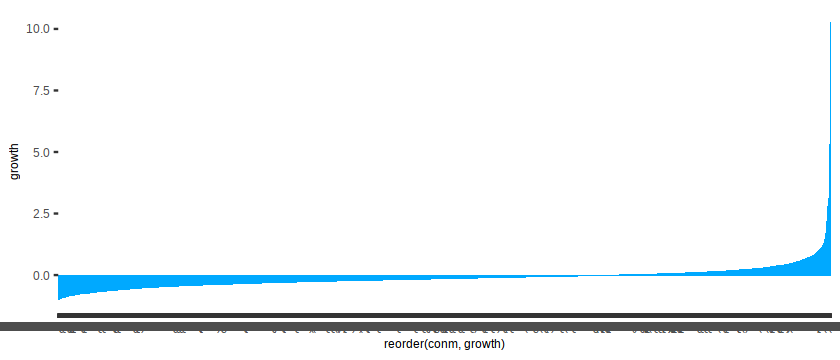

In [16]:
# A bar chart to visualize growth across companies (sorted lowest to highest).

ggplot(data=new_data, aes(x=reorder(conm, growth), y=growth)) +
    geom_bar(stat="identity")

observations,variables
4305,2714


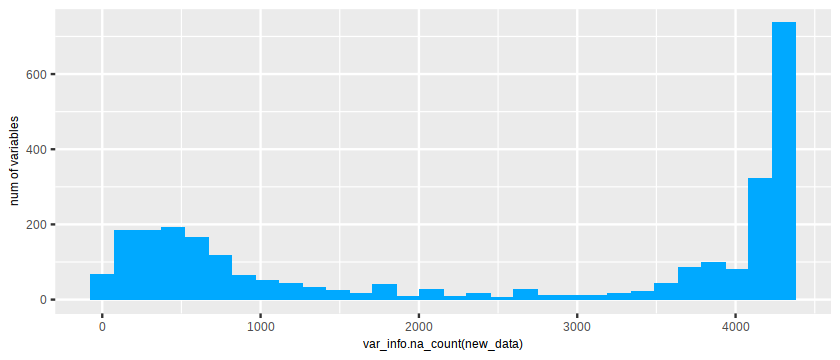

In [17]:
# number of observations with missing data on the horizontal axis,
#  number of variables on the vertical axis. 
size(new_data)
ggplot() + geom_histogram(aes(x=var_info.na_count(new_data)), bins = 30) + ylab("num of variables")


,colnames,var
5,fyearq.q1,0.07880943
6,fqtr.q1,0.78385438
7,fyr.q1,8.36122005
16,ajexq.q1,0.10560762
17,ajpq.q1,0.10519238
22,currtrq.q1,0.04237685


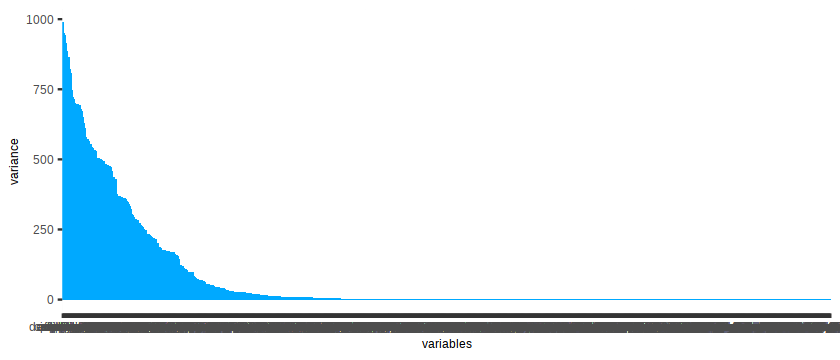

In [18]:
numeric = unlist(lapply(new_data, is.numeric))
variance = new_data[, numeric]

var = apply(variance, 2, var, na.rm=TRUE)>=1000
column_names = colnames(variance)[which(!var)]

#new variance data frames
variance_df = data.frame(colnames = colnames(new_data), var = var_info.var(new_data))
rownames(variance_df) = c()

#Merge Together
variance_df = variance_df[variance_df$colnames %in% column_names,]
head(variance_df)

ggplot(variance_df) +
    geom_bar(aes(x=reorder(colnames, -var), y = var), stat = "identity") + ylab("variance") + xlab("variables")

In [19]:
# 3D scatterplot projection to visualize revtq.q4 vs. prccq.q4 vs. growth
t = new_data[(new_data$revtq.q4 <= 1000 & new_data$prccq.q4 <= 100) & new_data$growth >= -1 & new_data$growth <= 5,]
plot3d(new_data[,c("revtq.q4","prccq.q4","growth")], type="s", col=PALETTE[c(1:3)])
grid3d(c("x","y","z"))
rglwidget(elementId="myplot3", width=400, height=400, reuse=FALSE)

HTML widgets cannot be represented in plain text (need html)

In [20]:
size(new_data)

observations,variables
4305,2714


## New Representation of Data

_<< Discuss this new representation of data. >>_

### Variable Selection

In [21]:
# Filter the data to include only predictor variables with at least 80% non-missing values.

new_data_variable_selection = subset(new_data, select = -c(prccq, growth, big_growth))
new_data_variable_selection = new_data_variable_selection[, -which(colMeans(is.na(new_data_variable_selection)) > 0.2)]

size(new_data_variable_selection)

observations,variables
4305,923


### Imputation

In [22]:
# Impute missing data:
ml = get_impute(new_data_variable_selection) 
new_data_variable_selection = put_impute(new_data_variable_selection, ml)
new_data_variable_selection[1:10,]

gvkey tic   conm                         datadate.q1 fyearq.q1 fqtr.q1
1  1004  AIR   AAR CORP                     02/28/2017  2016      3      
2  1045  AAL   AMERICAN AIRLINES GROUP INC  03/31/2017  2017      1      
3  1050  CECE  CECO ENVIRONMENTAL CORP      03/31/2017  2017      1      
4  1062  ASA   ASA GOLD AND PRECIOUS METALS 02/28/2017  2017      1      
5  1072  AVX   AVX CORP                     03/31/2017  2016      4      
6  1075  PNW   PINNACLE WEST CAPITAL CORP   03/31/2017  2017      1      
7  1076  AAN   AARON'S INC                  03/31/2017  2017      1      
8  1078  ABT   ABBOTT LABORATORIES          03/31/2017  2017      1      
9  1094  ACETQ ACETO CORP                   03/31/2017  2017      3      
10 1097  ACMTA ACMAT CORP  -CL A            03/31/2017  2017      1      
   fyr.q1 indfmt.q1 consol.q1 popsrc.q1 datafmt.q1 cusip.q1  acctchgq.q1
1   5     INDL      C         D         STD        000361105            
2  12     INDL      C         D         STD        02376R102            
3  12     INDL      C         D         STD        125141101            
4  11     INDL      C         D         STD        G3156P103            
5   3     INDL      C         D         STD        002444107            
6  12     INDL      C         D         STD        723484101            
7  12     INDL      C         D         STD        002535300            
8  12     INDL      C         D         STD        002824100            
9   6     INDL      C         D         STD        004446100            
10 12     INDL      C         D         STD        004616207            
   acctstdq.q1 ajexq.q1 ajpq.q1 bsprq.q1 compstq.q1 curcdq.q1 curncdq.q1
1  DS          1        1                AZ         USD       USD       
2  DS          1        1                AC         USD       USD       
3  DS          1        1                           USD       USD       
4  DU          1        1       GB                  USD       USD       
5  DS          1        1                           USD       USD       
6  DS          1        1                           USD       USD       
7  DS          1        1       GB                  USD       USD       
8  DS          1        1                           USD       USD       
9  DS          1        1                           USD       USD       
10 DS          1        1       GB                  USD       USD       
   currtrq.q1 datacqtr.q1 datafqtr.q1 finalq.q1 ogmq.q1 rp.q1 scfq.q1  srcq.q1
1  1          2017Q1      2016Q3      Y                 Q     7.000000 5      
2  1          2017Q1      2017Q1      Y                 Q     7.000000 5      
3  1          2017Q1      2017Q1      Y                 Q     7.000000 5      
4  1          2017Q1      2017Q1      Y                 Q     6.998605 3      
5  1          2017Q1      2016Q4      Y                 Q     7.000000 5      
6  1          2017Q1      2017Q1      Y                 Q     7.000000 5      
7  1          2017Q1      2017Q1      Y                 Q     7.000000 5      
8  1          2017Q1      2017Q1      Y                 Q     7.000000 5      
9  1          2017Q1      2017Q3      Y                 Q     7.000000 5      
10 1          2017Q1      2017Q1      Y                 Q     7.000000 3      
   staltq.q1 updq.q1 apdedateq.q1 fdateq.q1  pdateq.q1  rdq.q1     acomincq.q1
1            3       02/28/2017   03/23/2017 03/21/2017 03/21/2017   -46.400  
2            3       03/31/2017   04/27/2017            04/27/2017 -5097.000  
3            3       03/31/2017   06/03/2017 05/14/2017 05/10/2017   -12.493  
4            3       02/28/2017   06/14/2017 04/06/2017                0.000  
5            3       03/31/2017   05/30/2017 04/28/2017 04/28/2017   -67.163  
6            3       03/31/2017   05/02/2017 05/02/2017 05/02/2017   -42.863  
7            3       03/31/2017   05/16/2017 04/28/2017 04/28/2017    -0.328  
8            3       03/31/2017   05/04/2017 04/19/2017 04/19/2017 -6532.000  
9  

### Principal Component Analysis

In [23]:

new_data_pca = new_data_variable_selection[, var_info.type(new_data_variable_selection) %in% c("numeric", "integer")]
a = new_data_pca[, var_info.var(new_data_pca) != 0]
size(a)

observations,variables
4305,737


In [24]:
# Perform a principal component analysis on the numeric and integer variables with non-zero variance
pca_data = prcomp(a, scale=TRUE, retx=TRUE)

new_data_variable_selection.centers = as.data.frame(pca_data$center)
new_data_variable_selection.weights = as.data.frame(pca_data$rotation)
new_data_variable_selection.pc = as.data.frame(pca_data$x)

head(new_data_variable_selection.centers)
head(new_data_variable_selection.weights)
head(new_data_variable_selection.pc)

,pca_data$center
gvkey,72888.013705
fyearq.q1,2016.913776
fqtr.q1,1.388889
fyr.q1,10.707893
ajexq.q1,1.025912
ajpq.q1,1.025405


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,PC51,PC52,PC53,PC54,PC55,PC56,PC57,PC58,PC59,PC60,PC61,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77,PC78,PC79,PC80,PC81,PC82,PC83,PC84,PC85,PC86,PC87,PC88,PC89,PC90,PC91,PC92,PC93,PC94,PC95,PC96,PC97,PC98,PC99,PC100,⋯,PC638,PC639,PC640,PC641,PC642,PC643,PC644,PC645,PC646,PC647,PC648,PC649,PC650,PC651,PC652,PC653,PC654,PC655,PC656,PC657,PC658,PC659,PC660,PC661,PC662,PC663,PC664,PC665,PC666,PC667,PC668,PC669,PC670,PC671,PC672,PC673,PC674,PC675,PC676,PC677,PC678,PC679,PC680,PC681,PC682,PC683,PC684,PC685,PC686,PC687,PC688,PC689,PC690,PC691,PC692,PC693,PC694,PC695,PC696,PC697,PC698,PC699,PC700,PC701,PC702,PC703,PC704,PC705,PC706,PC707,PC708,PC709,PC710,PC711,PC712,PC713,PC714,PC715,PC716,PC717,PC718,PC719,PC720,PC721,PC722,PC723,PC724,PC725,PC726,PC727,PC728,PC729,PC730,PC731,PC732,PC733,PC734,PC735,PC736,PC737
gvkey,0.004113760,-0.0010863507,-0.001602883,0.0150274345,-0.003019971,0.010509261,-0.005215190,0.013208770,0.005363913,-0.0003554898,0.02637808,-0.005351373,0.006351561,-0.02875240,0.01806354,-0.02405208,0.01740806,-0.017475077,0.013943240,-0.009489248,0.026968551,-0.046590446,-0.017977210,0.02713166,-0.006575136,-0.009387974,0.035479952,-0.01283211,0.04281322,-0.081987868,0.075424677,-0.021460972,0.0502206006,-0.015369751,0.029058759,-0.034407681,0.02043351,-0.066419457,0.0137641511,-0.0472005509,0.0355043218,-0.050170461,0.06265717,-0.125608151,0.043424197,-0.029992023,0.037817923,-0.012652723,0.042988559,-0.034557497,0.007957447,0.013364422,-0.024944282,0.011182224,-0.017729545,-0.001027372,-0.001312142,0.026515507,-0.004573887,-0.006721838,0.014742196,-0.006068592,-0.019056792,0.0204318487,0.012746583,-0.0298617851,0.0025547884,0.0068988594,0.010803232,0.0027365262,-0.008318769,-0.034303820,0.03738465050,0.017017454,0.058304488,-0.052655002,-0.013108600,-0.0281850804,-0.067118888,0.062508140,0.07574733,0.017268407,-0.073170505,-0.0006506867,-0.089554072,0.0166795565,0.026544492,0.071593528,0.0414097922,-0.028451373,-0.016831347,0.111774386,-0.007104621,0.014364603,-0.045191458,0.0108498796,-0.079547469,0.263715531,-0.174597552,0.009440991,⋯,0.000000635936,0.000001105933,0.000006475364,0.000003723604,0.000011582563,0.00001221081,0.000005932372,0.0000003284938,0.0000009999392,0.0000110570066,0.000001317498,0.000008332253,0.000005813545,0.000006080562,0.000001969859,0.0000009756551,0.000014157550,0.000008880156,0.000007755018,0.000003287071,0.000007348422,0.000003220252,0.00000286256,0.000002112418,0.000002204677,0.000001106457,0.0000005382807,0.0000003075228,0.000002762139,0.000004701182,0.0000038589264,0.000003451480,0.000003110223,0.0000009746505,0.00000301795,0.0000003031319,0.0000005458651,0.0000002281882,0.00000063138196,0.0000001086887,0.0000016024770,0.0000001224829,0.0000006418286,0.0000005280023,0.0000003812871,0.0000004703711,0.00000033128197,0.0000001624202,0.00000016224573,0.0000001108328,0.0000002484597,0.00000002504862,0.00000004858835,0.00000002121889,0.00000002428554,0.00000003719385,0.00000003494673,0.000000004831983,0.000000008061223,0.0000000051590123,0.0000000004543513,0.000000001223892,0.0000000004989485,0.0000000000718527,0.0000000000006197268,5.224822e-16,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
fyearq.q1,0.002578837,0.0015727074,-0.007446717,-0.0062711251,-0.003155141,-0.028351944,-0.015141259,0.035014096,-0.085215958,-0.0476368961,0

PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28,PC29,PC30,PC31,PC32,PC33,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49,PC50,PC51,PC52,PC53,PC54,PC55,PC56,PC57,PC58,PC59,PC60,PC61,PC62,PC63,PC64,PC65,PC66,PC67,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77,PC78,PC79,PC80,PC81,PC82,PC83,PC84,PC85,PC86,PC87,PC88,PC89,PC90,PC91,PC92,PC93,PC94,PC95,PC96,PC97,PC98,PC99,PC100,⋯,PC638,PC639,PC640,PC641,PC642,PC643,PC644,PC645,PC646,PC647,PC648,PC649,PC650,PC651,PC652,PC653,PC654,PC655,PC656,PC657,PC658,PC659,PC660,PC661,PC662,PC663,PC664,PC665,PC666,PC667,PC668,PC669,PC670,PC671,PC672,PC673,PC674,PC675,PC676,PC677,PC678,PC679,PC680,PC681,PC682,PC683,PC684,PC685,PC686,PC687,PC688,PC689,PC690,PC691,PC692,PC693,PC694,PC695,PC696,PC697,PC698,PC699,PC700,PC701,PC702,PC703,PC704,PC705,PC706,PC707,PC708,PC709,PC710,PC711,PC712,PC713,PC714,PC715,PC716,PC717,PC718,PC719,PC720,PC721,PC722,PC723,PC724,PC725,PC726,PC727,PC728,PC729,PC730,PC731,PC732,PC733,PC734,PC735,PC736,PC737
3.4371231,-0.2260719,0.4220180,-0.6326422,1.5550509,-0.5650989,2.0762355,-4.7809366,2.57837534,1.08343819,-1.0852790,-0.7351277,0.2918953,6.8480433,-1.3871612,1.1200720,0.2210991,0.9914828,-0.79834108,0.20001133,-0.31771792,1.0539380,1.67813281,-0.8672219,-0.37905631,-1.16129629,1.0867702,-1.0412642,0.8547673,-0.1336883,-0.9056983,0.2780267,-0.72462144,-0.018625133,-1.0475663,0.37038314,0.09388485,1.00864500,-0.6290530,0.56007039,-0.13098834,0.52265832,-1.7038187,2.7211571,-0.34390112,0.227859079,-0.09971139,-0.57797892,-0.29036026,0.21928328,-0.47636356,-0.1945795,-0.05066614,-0.07005866,0.4389614,-0.2723389,-0.099977768,-0.315330206,-0.6652111,0.59191807,0.48702283,0.34729539,-0.29551715,-0.284412824,0.40647730,-0.15538404,0.05869476,0.58074474,0.23229255,-0.97475993,0.2748880,1.47194389,-0.26981678,-0.858540100,1.0660820,-1.48377211,-2.216605696,-2.06770952,-4.03616804,-0.75023659,-3.81854383,-1.856007787,1.59975313,-0.66278074,-2.42575448,0.81083565,-0.005509483,1.9140389,-1.64882918,-0.59361913,0.3067276,1.62462093,-0.2865575,0.20572160,0.14645964,0.44112856,0.12338222,-0.9757801,-0.1121492,-0.46611931,⋯,0.00027983357,-0.00023090758,0.0004433358,0.00008563764,0.00022746862,-0.00007650780,0.00002915370,0.00007547395,-0.00015238488,-0.00014919475,-0.00002906592,0.000043237916,0.000312392577,0.00029691890,0.00015236885,0.000148090698,-0.000161156023,-0.00003421426,0.00028855696,0.000154113664,-0.000162176478,-0.00028822508,-0.000101330149,-0.00004300331,0.00032482558,0.000082546432,-0.000009533542,-0.000021616792,0.00020739534,-0.000044487222,-0.000085922027,0.000004819613,-0.000190430166,-0.000036292968,-0.00006708483,-0.00006753966,0.000176456586,-0.000033321117,0.000030015022,-0.000012817335,0.000006835853,-0.0000124378999,-0.0000147975664,-0.0000082422385,0.0000147049155,-0.0000114649924,-0.0000023735536,0.0000155901469,-0.0000091170143,0.0000056229947,-0.000008896972,0.0000074087280,-0.0000020323700,-0.0000041194253,-0.0000020283956,-0.00000096241526,-0.0000030301529,-0.00000012171873,-0.00000065892935,-0.000000025429233,-0.00000001472213,-0.000000001709996,-0.0000000174902813,0.000000003685459,-0.0000000000371691892,3.455461e-15,1.155109e-15,-2.504507e-16,-3.478663e-16,1.499452e-15,6.433656e-16,-5.169476e-16,-3.599551e-16,-2.428613e-16,7.502679e-16,4.361203e-16,8.686628e-16,5.126108e-16,4.380177e-17,7.840950e-16,1.170938e-16,4.015885e-16,-2.081668e-17,1.092876e-15,1.465841e-15,-4.423545e-17,-2.053913e-15,4.544976e-16,3.582204e-16,4.649059e-16,-1.491862e-16,-5.521842e-16,8.478461e-16,1.257675e-16,-6.956241e-16,-3.263449e-17,-1.875128e-16,-1.734723e-18,3.599551e-17,-2.099015e-16
-12.0332067,0.8045109,5.9180179,-0.8018754,6.7210451,-3.0447560,0.3546613,-0.9115091,-0.08658059,-3.11308754,-2.0981728,-0.6351669,2.3283523,-1.9116502,0.3221275,0.7248502,-0.7006368,0.6671353,-0.97108690,0.17976843,-1.29237646,1.3577810,0.94279445,1.0363612,0.75825338,-0.1

variable,sd,variance,cum_variance,relative_variance,cum_relative_variance
PC1,12.820664,164.369435,164.3694,0.33795923,0.3379592
PC2,7.361713,54.194814,218.5642,0.11142970,0.4493889
PC3,6.404044,41.011783,259.5760,0.08432414,0.5337131
PC4,5.011855,25.118686,284.6947,0.05164641,0.5853595
PC5,4.515024,20.385444,305.0802,0.04191442,0.6272739
PC6,4.461475,19.904760,324.9849,0.04092608,0.6682000
PC7,4.170973,17.397014,342.3819,0.03576992,0.7039699
PC8,4.108424,16.879151,359.2611,0.03470514,0.7386750
PC9,3.946199,15.572488,374.8336,0.03201852,0.7706936
PC10,3.707323,13.744244,388.5778,0.02825948,0.7989530


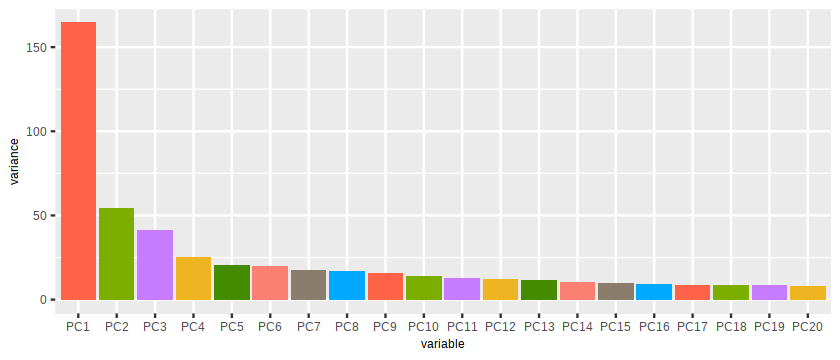

In [25]:
variable = c("PC1", "PC2", "PC3", "PC4", "PC5", "PC6", "PC7", "PC8",
             "PC9", "PC10", "PC11", "PC12", "PC13", "PC14", "PC15", 
             "PC16", "PC17", "PC18", "PC19", "PC20")

variable = factor(variable, levels = variable)

sd = variance = c(sd(new_data_variable_selection.pc$PC1), sd(new_data_variable_selection.pc$PC2), 
           sd(new_data_variable_selection.pc$PC3), sd(new_data_variable_selection.pc$PC4), 
           sd(new_data_variable_selection.pc$PC5), sd(new_data_variable_selection.pc$PC6), 
           sd(new_data_variable_selection.pc$PC7), sd(new_data_variable_selection.pc$PC8), 
           sd(new_data_variable_selection.pc$PC9), sd(new_data_variable_selection.pc$PC10), 
           sd(new_data_variable_selection.pc$PC11),sd(new_data_variable_selection.pc$PC12), 
           sd(new_data_variable_selection.pc$PC13),sd(new_data_variable_selection.pc$PC14), 
           sd(new_data_variable_selection.pc$PC15),sd(new_data_variable_selection.pc$PC16), 
           sd(new_data_variable_selection.pc$PC17),sd(new_data_variable_selection.pc$PC18),
           sd(new_data_variable_selection.pc$PC19),sd(new_data_variable_selection.pc$PC20))

variance = c(var(new_data_variable_selection.pc$PC1), var(new_data_variable_selection.pc$PC2), 
           var(new_data_variable_selection.pc$PC3), var(new_data_variable_selection.pc$PC4), 
           var(new_data_variable_selection.pc$PC5), var(new_data_variable_selection.pc$PC6), 
           var(new_data_variable_selection.pc$PC7), var(new_data_variable_selection.pc$PC8), 
           var(new_data_variable_selection.pc$PC9), var(new_data_variable_selection.pc$PC10), 
           var(new_data_variable_selection.pc$PC11),var(new_data_variable_selection.pc$PC12), 
           var(new_data_variable_selection.pc$PC13),var(new_data_variable_selection.pc$PC14), 
           var(new_data_variable_selection.pc$PC15),var(new_data_variable_selection.pc$PC16), 
           var(new_data_variable_selection.pc$PC17),var(new_data_variable_selection.pc$PC18),
           var(new_data_variable_selection.pc$PC19),var(new_data_variable_selection.pc$PC20))

cum_variance = cumsum(variance)
relative_variance = variance / sum(variance)
cum_relative_variance = cumsum(relative_variance)

scree.pc = data.frame(variable, sd, variance, cum_variance, relative_variance, cum_relative_variance)
scree.pc

ggplot(scree.pc) + geom_col(aes(x=variable, y=variance, fill=variable)) +
scale_fill_manual(values=PALETTE[2:21]) + theme.no_legend

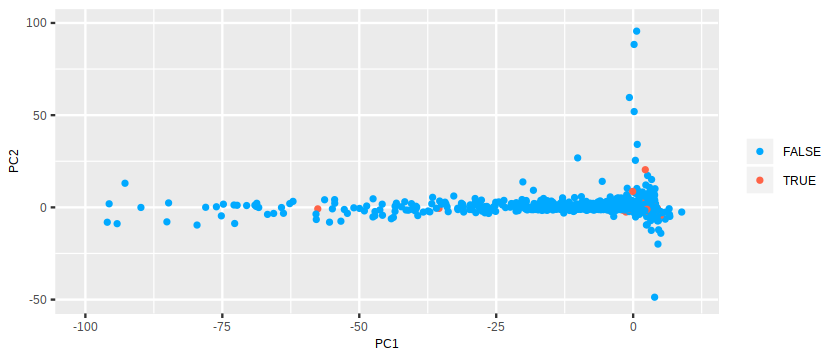

In [26]:
# 2D scatterplot to visualize PC1 vs PC2 vs big_growth
PC1 = new_data_variable_selection.pc$PC1
PC2 = new_data_variable_selection.pc$PC2
big_growth = new_data$big_growth
plot_twod = cbind(new_data_variable_selection.pc[,c("PC1", "PC2")], big_growth = new_data[, "big_growth"])

ggplot(plot_twod) + xlim(-100,10) + ylim(-50,100)+ geom_point(aes(x=PC1, y=PC2, color= big_growth),na.rm = TRUE)

### Cluster Analysis

In [27]:
#Filtered the (imputed) data to include only incorp.q1 and state.q1 variables.

cluster_analysis_data = new_data_variable_selection[c("incorp.q1", "state.q1")]
cluster_analysis_data.d = dummify(cluster_analysis_data)
cluster_analysis_data.d = cluster_analysis_data.d[,-c(2)]
cluster_analysis_data.d = cluster_analysis_data.d[,-c(1)]


size(cluster_analysis_data.d)
head(cluster_analysis_data.d)

observations,variables
4305,113


incorp.q1AZ,incorp.q1GA,incorp.q1IL,incorp.q1NY,incorp.q1CT,incorp.q1NV,incorp.q1HI,incorp.q1FL,incorp.q1TX,incorp.q1PA,incorp.q1OK,incorp.q1MA,incorp.q1OH,incorp.q1MN,incorp.q1CA,incorp.q1WI,incorp.q1RI,incorp.q1MD,incorp.q1IN,incorp.q1PR,incorp.q1VA,incorp.q1NJ,incorp.q1SD,incorp.q1MO,incorp.q1IA,incorp.q1LA,incorp.q1KY,incorp.q1WA,incorp.q1MI,incorp.q1TN,incorp.q1NC,incorp.q1MS,incorp.q1CO,incorp.q1AR,incorp.q1ID,incorp.q1KS,incorp.q1UT,incorp.q1OR,incorp.q1NM,incorp.q1SC,incorp.q1NH,incorp.q1NE,incorp.q1DC,incorp.q1ME,incorp.q1VI,incorp.q1WV,incorp.q1MT,incorp.q1AK,incorp.q1VT,incorp.q1WY,incorp.q1ND,incorp.q1GU,incorp.q1AL,state.q1IL,state.q1TX,state.q1CA,state.q1SC,state.q1AZ,state.q1GA,state.q1NY,state.q1CT,state.q1FL,state.q1,state.q1ON,state.q1PA,state.q1NC,state.q1WA,state.q1HI,state.q1NJ,state.q1NV,state.q1MA,state.q1ID,state.q1OH,state.q1MN,state.q1WI,state.q1AR,state.q1CO,state.q1KY,state.q1RI,state.q1IN,state.q1PR,state.q1VA,state.q1NE,state.q1SD,state.q1MO,state.q1QC,state.q1IA,state.q1LA,state.q1DE,state.q1MI,state.q1OK,state.q1TN,state.q1DC,state.q1MS,state.q1MD,state.q1AL,state.q1ND,state.q1KS,state.q1UT,state.q1OR,state.q1NH,state.q1NM,state.q1AB,state.q1ME,state.q1BC,state.q1SK,state.q1VI,state.q1WV,state.q1MT,state.q1AK,state.q1VT,state.q1GU,state.q1WY
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [28]:
# Construct a Guassian mixture model by expectation-maximization to organize the data into 4 clusters
set.seed(12345)
data.norm = scale(cluster_analysis_data.d)
number_of_clusters = 4

cluster_analysis_data.d$cluster = factor(kmeans(data.norm, number_of_clusters, nstart = 1)$cluster)
head(cluster_analysis_data.d)

incorp.q1AZ,incorp.q1GA,incorp.q1IL,incorp.q1NY,incorp.q1CT,incorp.q1NV,incorp.q1HI,incorp.q1FL,incorp.q1TX,incorp.q1PA,incorp.q1OK,incorp.q1MA,incorp.q1OH,incorp.q1MN,incorp.q1CA,incorp.q1WI,incorp.q1RI,incorp.q1MD,incorp.q1IN,incorp.q1PR,incorp.q1VA,incorp.q1NJ,incorp.q1SD,incorp.q1MO,incorp.q1IA,incorp.q1LA,incorp.q1KY,incorp.q1WA,incorp.q1MI,incorp.q1TN,incorp.q1NC,incorp.q1MS,incorp.q1CO,incorp.q1AR,incorp.q1ID,incorp.q1KS,incorp.q1UT,incorp.q1OR,incorp.q1NM,incorp.q1SC,incorp.q1NH,incorp.q1NE,incorp.q1DC,incorp.q1ME,incorp.q1VI,incorp.q1WV,incorp.q1MT,incorp.q1AK,incorp.q1VT,incorp.q1WY,incorp.q1ND,incorp.q1GU,incorp.q1AL,state.q1IL,state.q1TX,state.q1CA,state.q1SC,state.q1AZ,state.q1GA,state.q1NY,state.q1CT,state.q1FL,state.q1,state.q1ON,state.q1PA,state.q1NC,state.q1WA,state.q1HI,state.q1NJ,state.q1NV,state.q1MA,state.q1ID,state.q1OH,state.q1MN,state.q1WI,state.q1AR,state.q1CO,state.q1KY,state.q1RI,state.q1IN,state.q1PR,state.q1VA,state.q1NE,state.q1SD,state.q1MO,state.q1QC,state.q1IA,state.q1LA,state.q1DE,state.q1MI,state.q1OK,state.q1TN,state.q1DC,state.q1MS,state.q1MD,state.q1AL,state.q1ND,state.q1KS,state.q1UT,state.q1OR,state.q1NH,state.q1NM,state.q1AB,state.q1ME,state.q1BC,state.q1SK,state.q1VI,state.q1WV,state.q1MT,state.q1AK,state.q1VT,state.q1GU,state.q1WY,cluster
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4


Warning message:
“Removed 19 rows containing missing values (geom_point).”

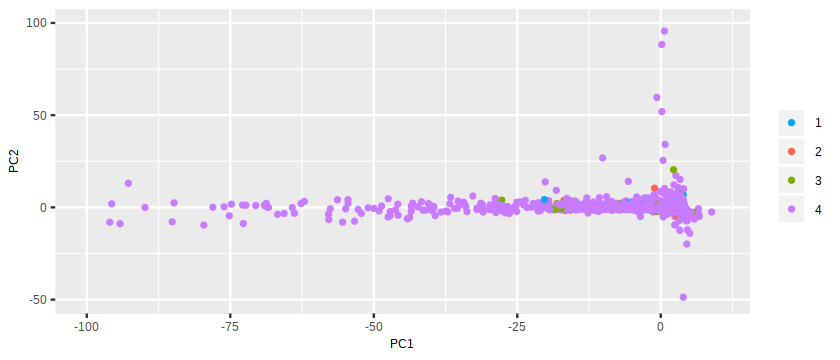

In [29]:
# 2D scatterplot to visualize PC1 vs PC2 vs cluster

plot_twod_cluster = cbind(new_data_variable_selection.pc[,c("PC1", "PC2")], cluster = cluster_analysis_data.d$cluster)

ggplot(plot_twod_cluster) + xlim(-100,10) + ylim(-50,100)+ 
geom_point(aes(x=PC1, y=PC2, color= cluster))

### Transform the Data

In [30]:
new_data_5.5 = data.frame(gvkey = new_data_variable_selection$gvkey, tic = new_data_variable_selection$tic,conm = new_data_variable_selection$conm, PC1 = new_data_variable_selection.pc$PC1,PC2 = new_data_variable_selection.pc$PC2, 
                          prccq = new_data$prccq, growth = new_data$growth, big_growth = new_data$big_growth)

size(new_data_5.5)
head(new_data_5.5)
class(new_data_5.5$big_growth)

observations,variables
4305,8


gvkey,tic,conm,PC1,PC2,prccq,growth,big_growth
1004,AIR,AAR CORP,3.4371231,-0.2260719,43.69,0.0507455507,FALSE
1045,AAL,AMERICAN AIRLINES GROUP INC,-12.0332067,0.8045109,32.11,-0.3828560446,FALSE
1050,CECE,CECO ENVIRONMENTAL CORP,3.9532234,-0.7553386,6.75,0.3157894737,TRUE
1062,ASA,ASA GOLD AND PRECIOUS METALS,3.6561434,-0.7981915,8.66,-0.2164739518,FALSE
1072,AVX,AVX CORP,2.9282228,-0.7104200,15.25,-0.1184971098,FALSE
1075,PNW,PINNACLE WEST CAPITAL CORP,0.3488491,1.1389605,85.20,0.0002347969,FALSE


[1] "logical"

## Classification Model for Prediction

### Investment Criteria

Restrict allocations to only companies predicted to have big_growth=TRUE.  Of these, choose the 12 companies with the largest gvkey values, and allocate 1/12 of the total investment to each of them. 

In [32]:
naive_data_5.5 = new_data_5.5
naive_data_5.5$prediction = prediction
portfolio_big_growth = naive_data_5.5[naive_data_5.5$prediction == 1, ]

#portfolio with 12 highest gvkeys for In-sample
portfolio_12 = portfolio_big_growth[order(-portfolio_big_growth$gvkey), ][1:12,] 
portfolio_12

ERROR: Error in rep(value, length.out = nrows): attempt to replicate an object of type 'closure'


### Build Model

In [ ]:
# A naive Bayes model to predict big_growth given PC1, PC2, and cluster (use laplace=TRUE).
naive_model = naiveBayes(big_growth ~ PC1+PC2, data = new_data_5.5, laplace = TRUE)
naive_model

### In-Sample Estimated Performance

In [ ]:
# Model's in-sample estimated accuracy, profit, and profit rate.
prob = predict(naive_model, new_data_5.5, type="raw")

prediction = as.class(prob, 'TRUE', cutoff = 0.5)#if it is above 0.5 then it will predict True

x = confusionMatrix(factor(prediction), factor(new_data_5.5$big_growth))$table


cm = x / sum(x)
fmt.cm(cm)

accuracy = (cm[1,1]+cm[2,2])/sum(cm) #sum is going to be 1
data.frame(insample_accuracy = accuracy)

### Out-of-Sample Estimated Performance

In [ ]:
# Partition the data into training (75%) and validation (25%)
set.seed(12345)
size(new_data_5.5)

training_size <- round(0.75 * size(new_data_5.5)[, "observations"])
validation_size <- round(0.25 * size(new_data_5.5)[, "observations"])
data.frame(training_size, validation_size)

row_index = as.numeric(rownames(new_data_5.5))
training_index = sample(row_index, training_size, replace = FALSE)
training_set = new_data_5.5[training_index,]
validation_set = new_data_5.5[-training_index,]

head(training_set)
head(validation_set)


In [ ]:
# Model's out-of-sample estimated accuracy, profit, and profit rate.
naive_model_out = naiveBayes(big_growth ~ PC1+PC2, data = training_set, laplace = TRUE)

prob = predict(naive_model_out, validation_set, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5) #check the true of false value

x = confusionMatrix(factor(prediction), factor(validation_set$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy = (cm[1,1]+cm[2,2])/sum(cm) #sum is going to be 1
data.frame(outsample_accuracy = accuracy)

validation_set$prediction = prediction

validation_big_growth = validation_set[validation_set$prediction == 1, ]

validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth

budget = 1000000
allocation = budget / 12
profit = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate = profit / budget

data.frame(accuracy, profit, profit_rate)

### 5-Fold Cross-Validation Estimated Performance

In [ ]:
# Partition the data into 5 folds (use set.seed(12345) and createFolds(...)).
set.seed(12345)

data = new_data_5.5
fold = createFolds(data$big_growth, k=5)

data1.train = data[setdiff(1:nrow(data), fold$Fold1),]
data1.test  = data[fold$Fold1,] 

data2.train = data[setdiff(1:nrow(data), fold$Fold2),]
data2.test  = data[fold$Fold2,] 

data3.train = data[setdiff(1:nrow(data), fold$Fold3),]
data3.test  = data[fold$Fold3,] 

data4.train = data[setdiff(1:nrow(data), fold$Fold4),]
data4.test  = data[fold$Fold4,] 

data5.train = data[setdiff(1:nrow(data), fold$Fold5),]
data5.test  = data[fold$Fold5,]

#first few row numbers of each fold
fold

In [ ]:
# Model's fold #1 estimated accuracy and profit.
naive_model_1 = naiveBayes(big_growth ~ PC1+PC2, data = data1.train, laplace = TRUE)

prob = predict(naive_model_1, data1.test, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5) #check the True of False value

x = confusionMatrix(factor(prediction), factor(data1.test$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy_1 = (cm[1,1]+cm[2,2])/sum(cm) 

data1.test$prediction = prediction

validation_big_growth = data1.test[data1.test$prediction == 1, ]

validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth

budget = 1000000
allocation = budget / 12
profit_1 = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate_1 = profit/(budget)

data.frame(accuracy_1, profit_1, profit_rate_1)

In [ ]:
# Model's fold #2 estimated accuracy and profit.
naive_model_2 = naiveBayes(big_growth ~ PC1+PC2, data = data2.train, laplace = TRUE)

prob = predict(naive_model_2, data2.test, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5)

x = confusionMatrix(factor(prediction), factor(data2.test$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy_2 = (cm[1,1]+cm[2,2])/sum(cm) 

data2.test$prediction = prediction

validation_big_growth = data2.test[data2.test$prediction == 1, ]

validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth

budget = 1000000
allocation = budget / 12
profit_2 = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate_2 = profit/(budget)

data.frame(accuracy_2, profit_2, profit_rate_2)

In [ ]:
# Model's fold #3 estimated accuracy and profit.
naive_model_3 = naiveBayes(big_growth ~ PC1+PC2, data = data3.train, laplace = TRUE)


prob = predict(naive_model_3, data3.test, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5)

x = confusionMatrix(factor(prediction), factor(data3.test$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy_3 = (cm[1,1]+cm[2,2])/sum(cm)


data3.test$prediction = prediction


validation_big_growth = data3.test[data3.test$prediction == 1, ]

validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth


budget = 1000000
allocation = budget / 12
profit_3 = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate_3 = profit/(budget)

data.frame(accuracy_3, profit_3, profit_rate_3)

In [ ]:
# Model's fold #4 estimated accuracy and profit.
naive_model_4 = naiveBayes(big_growth ~ PC1+PC2, data = data4.train, laplace = TRUE)

prob = predict(naive_model_4, data4.test, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5)

x = confusionMatrix(factor(prediction), factor(data4.test$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy_4 = (cm[1,1]+cm[2,2])/sum(cm) 

data4.test$prediction = prediction


validation_big_growth = data4.test[data4.test$prediction == 1, ]


validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth

budget = 1000000
allocation = budget / 12
profit_4 = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate_4 = profit/(budget)

data.frame(accuracy_4, profit_4, profit_rate_4)

In [ ]:
# Model's fold #5 estimated accuracy and profit.
naive_model_5 = naiveBayes(big_growth ~ PC1+PC2, data = data5.train, laplace = TRUE)

prob = predict(naive_model_5, data2.test, type="raw")
prediction = as.class(prob, 'FALSE', cutoff = 0.5) 

x = confusionMatrix(factor(prediction), factor(data5.test$big_growth))$table
cm = x / sum(x)
fmt.cm(cm)

accuracy_5 = (cm[1,1]+cm[2,2])/sum(cm)

data5.test$prediction = prediction

validation_big_growth = data5.test[data5.test$prediction == 1, ]


validation_big_growth = validation_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
validation_big_growth

budget = 1000000
allocation = budget / 12
profit_5 = sum((1 + validation_big_growth$growth ) * allocation) - budget
profit_rate_5 = profit/(budget)

data.frame(accuracy_5, profit_5, profit_rate_5)

In [ ]:
# Model's 5-fold cross-validation estimated accuracy, profit, and profit rate.
cross_validation_accruacy = mean(c(accuracy_1, accuracy_2, accuracy_3, accuracy_4, accuracy_5))
cross_validation_profit = mean(c(profit_1, profit_2, profit_3, profit_4, profit_5))

rbind(data.frame(model = "model_1", accuracy = accuracy_1, profit = profit_1),
      data.frame(model = "model_2", accuracy = accuracy_2, profit = profit_2),
      data.frame(model = "model_3", accuracy = accuracy_3, profit = profit_3),
      data.frame(model = "model_4", accuracy = accuracy_4, profit = profit_4),
      data.frame(model = "model_5", accuracy = accuracy_5, profit = profit_5))

data.frame(cross_validation_accruacy, cross_validation_profit)

## Regression Model for Prediction

### Investment Criteria

Choose the 12 companies with the highest predicted growth values, and allocate 1/12 of the total investment to each of them. 

### Build Model

In [ ]:
# Linear regression model to predict growth given PC1 and PC2.
regression_model = lm(growth ~ PC1+PC2, data = new_data_5.5)
regression_model

In [ ]:
new_data_5.5

### In-Sample Estimated Performance

In [ ]:
# Model's in-sample estimated RMSE, profit, and profit rate.

prediction = predict(regression_model, new_data_5.5)
error = prediction-new_data_5.5$growth
square_error = error^2
RMSE = sqrt(mean(square_error))



regression_7 = new_data_5.5
regression_7$prediction = prediction


portfolio_7 = regression_7[order(-regression_7$prediction),][1:12,]


budget = 1000000
allocation = budget / 12
inprofit = sum((1 + portfolio_7$growth) * allocation) - budget
inprofit_rate = inprofit / (budget)

data.frame(RMSE, profit = inprofit, profit_rate = inprofit_rate)

### Out-of-Sample Estimated Performance

In [ ]:
# Partition the data into training (75%) and validation (25%)
set.seed(12345)
size(new_data_5.5)
training_size <- round(0.75 * size(new_data_5.5)[, "observations"])
validation_size <- round(0.25 * size(new_data_5.5)[, "observations"])
data.frame(training_size, validation_size)
row_index = as.numeric(rownames(new_data_5.5))
training_index = sample(row_index, training_size, replace = FALSE)
training_set = new_data_5.5[training_index,]
validation_set = new_data_5.5[-training_index,]

head(training_set)
head(validation_set)


In [ ]:
# Model's out-of-sample estimated RMSE, profit, and profit rate.

regression_model = lm(growth ~ PC1+PC2, data = training_set)
regression_model

prediction = predict(regression_model, validation_set)
error = prediction- validation_set$growth
square_error = error^2
RMSE = sqrt(mean(square_error))



###calculation###
budget = 1000000
allocation = budget / 12

portfolio_7.4 = validation_set[order(-prediction),][1:12,]


inprofit = sum((1 + portfolio_7.4$growth) * allocation) - budget
inprofit_rate = inprofit / (budget)

data.frame(RMSE, profit = inprofit, profit_rate = inprofit_rate)

### 5-Fold Cross-Validation Estimated Performance

In [ ]:
# Partition the data into 5 folds (use set.seed(12345) and createFolds(...)).
set.seed(12345)

data = new_data_5.5
fold = createFolds(data$big_growth, k=5)

data_1.train = data[setdiff(1:nrow(data), fold$Fold1),]
data_1.test  = data[fold$Fold1,] 

data_2.train = data[setdiff(1:nrow(data), fold$Fold2),]
data_2.test  = data[fold$Fold2,] 

data_3.train = data[setdiff(1:nrow(data), fold$Fold3),]
data_3.test  = data[fold$Fold3,] 

data_4.train = data[setdiff(1:nrow(data), fold$Fold4),]
data_4.test  = data[fold$Fold4,] 

data_5.train = data[setdiff(1:nrow(data), fold$Fold5),]
data_5.test  = data[fold$Fold5,]

#first few row numbers of each fold
fold

In [ ]:
# Model's fold #1 estimated RMSE and profit.
regression_model_1 = lm(growth ~ PC1+PC2, data = data_1.train)

prediction = predict(regression_model_1, data_1.test)

error = prediction- validation_set$growth
square_error = error^2
RMSE_1 = sqrt(mean(square_error))

budget = 1000000
allocation = budget / 12


portfolio_7.4 = validation_set[order(-prediction),][1:12,]


sampleprofit_1 = sum((1 + portfolio_7.4$growth) * allocation) - budget
sampleprofit_rate_1 = inprofit_1 / (budget)

data.frame(RMSE_1, profit_1 = sampleprofit_1, profit_rate_1 = sampleprofit_rate_1)

In [ ]:
# Moodel's fold #2 estimated RMSE and profit.
regression_model_2 = lm(growth ~ PC1+PC2, data = data_2.train)

prediction = predict(regression_model_2, data_2.test)

error = prediction- validation_set$growth
square_error = error^2
RMSE_2 = sqrt(mean(square_error))
portfolio_7.4 = validation_set[order(-prediction),][1:12,]


sampleprofit_2 = sum((1 + portfolio_7.4$growth) * allocation) - budget
sampleprofit_rate_2 = inprofit_2 / (budget)

data.frame(RMSE_2, profit_2 = sampleprofit_2, profit_rate_2 = sampleprofit_rate_2)

In [ ]:
# Model's fold #3 estimated RMSE and profit.
regression_model_3 = lm(growth ~ PC1+PC2, data = data_3.train)

prediction = predict(regression_model_3, data_3.test)

error = prediction- validation_set$growth
square_error = error^2
RMSE_3 = sqrt(mean(square_error))

portfolio_7.4 = validation_set[order(-prediction),][1:12,]


sampleprofit_3 = sum((1 + portfolio_7.4$growth) * allocation) - budget
sampleprofit_rate_3 = inprofit_3 / (budget)

data.frame(RMSE_3, profit_3 = sampleprofit_3, profit_rate_3 = sampleprofit_rate_3)

In [ ]:
# Model's fold #4 estimated RMSE and profit.
regression_model_4 = lm(growth ~ PC1+PC2, data = data_1.train)

prediction = predict(regression_model_4, data_4.test)

error = prediction- validation_set$growth
square_error = error^2
RMSE_4 = sqrt(mean(square_error))


portfolio_7.4 = validation_set[order(-prediction),][1:12,]


sampleprofit_4 = sum((1 + portfolio_7.4$growth) * allocation) - budget
sampleprofit_rate_4 = inprofit_4 / (budget)

data.frame(RMSE_4, profit_4 = sampleprofit_4, profit_rate_4 = sampleprofit_rate_4)

In [ ]:
# Model's fold #5 estimated RMSE and profit.
regression_model_5 = lm(growth ~ PC1+PC2, data = data_5.train)

prediction = predict(regression_model_5, data_5.test)

error = prediction- validation_set$growth
square_error = error^2
RMSE_5 = sqrt(mean(square_error))

portfolio_7.4 = validation_set[order(-prediction),][1:12,]

sampleprofit_5 = sum((1 + portfolio_7.4$growth) * allocation) - budget
sampleprofit_rate_5 = sampleprofit_5 / (budget)

data.frame(RMSE_5, profit_5 = sampleprofit_5, profit_rate_5 = sampleprofit_rate_5)

In [ ]:
# Model's 5-fold cross-validation estimated RMSE, profit, and profit rate.
cross_validation_RMSE = mean(c(RMSE_1, RMSE_2, RMSE_3, RMSE_4, RMSE_5))
cross_validation_profit = mean(c(inprofit_1, inprofit_2, inprofit_3, inprofit_4, inprofit_5))
cross_validation_profit_rate = mean(c(inprofit_rate_1, inprofit_rate_2, inprofit_rate_3, inprofit_rate_4, inprofit_rate_5))

rbind(data.frame(model = "model_1", RMSE = RMSE_1, profit = sampleprofit_1, profit_rate = sampleprofit_rate_1),
      data.frame(model = "model_2", RMSE = RMSE_2, profit = sampleprofit_2, profit_rate = sampleprofit_rate_2),
      data.frame(model = "model_3", RMSE = RMSE_3, profit = sampleprofit_3, profit_rate = sampleprofit_rate_3),
      data.frame(model = "model_4", RMSE = RMSE_4, profit = sampleprofit_4, profit_rate = sampleprofit_rate_4),
      data.frame(model = "model_5", RMSE = RMSE_5, profit = sampleprofit_5, profit_rate = sampleprofit_rate_5))

data.frame(cross_validation_RMSE, cross_validation_profit, cross_validation_profit_rate)

## Tune Model

In [ ]:
# Choosing the better of predcitive models (use mymodel = ...).

mymodel = naive_model_1
mymodel

## Deploy Model

### Retrieve Investment Opportunities

In [ ]:
data.opportunities = read.csv("Investment Opportunities.csv", header=TRUE)
size(data.opportunities)
data.opportunities[1:6,]


### Selected Data for 2018

#### Retrieve Raw Test Data

In [ ]:
# Retrieve the 2018 data (or use the 2018 data retrieved earlier).
# Filtered the data to include only companies listed as investment opportunities.
data_2018 = read.csv("Company Fundamentals 2018.csv")
data_2018_filtered = data_2018[data_2018$conm %in% data.opportunities$conm, ]

size(data_2018_filtered)
data_2018_filtered[1, ]

#### Partition Data by Calendar Quarter 

To partition the dataset by calendar quarter in which information is reported, first add a synthetic variable to indicate such.  Then partition into four new datasets, one for each quarter, and drop the quarter variables. Additionally, filter the observations to include only those with non-missing `prccq`.  Then remove any observations about companies that reported more than once per quarter.  Then change all the variable names (except for the `gvkey`, `tic`, and `conm` variables) by suffixing them with quarter information - e.g., in the Quarter 1 dataset, `prccq` becomes `prccq.q1`, etc.

In [ ]:
# Partition the dataset
datax = data_2018_filtered
datax$quarter = quarter(mdy(datax[,2]))
 
data.current.q1 = datax[(datax$quarter==1) & !is.na(datax$prccq), -ncol(datax)] 
data.current.q2 = datax[(datax$quarter==2) & !is.na(datax$prccq), -ncol(datax)]
data.current.q3 = datax[(datax$quarter==3) & !is.na(datax$prccq), -ncol(datax)]
data.current.q4 = datax[(datax$quarter==4) & !is.na(datax$prccq), -ncol(datax)]

data.current.q1 = data.current.q1[!duplicated(data.current.q1$gvkey),]
data.current.q2 = data.current.q2[!duplicated(data.current.q2$gvkey),]
data.current.q3 = data.current.q3[!duplicated(data.current.q3$gvkey),]
data.current.q4 = data.current.q4[!duplicated(data.current.q4$gvkey),]

colnames(data.current.q1)[-c(1, 10, 12)] = paste0(colnames(data.current.q1)[-c(1, 10, 12)], ".q1")
colnames(data.current.q2)[-c(1, 10, 12)] = paste0(colnames(data.current.q2)[-c(1, 10, 12)], ".q2")
colnames(data.current.q3)[-c(1, 10, 12)] = paste0(colnames(data.current.q3)[-c(1, 10, 12)], ".q3")
colnames(data.current.q4)[-c(1, 10, 12)] = paste0(colnames(data.current.q4)[-c(1, 10, 12)], ".q4")

#### Consolidate Data by Company

Consolidate the four quarter datasets into one dataset, with one observation per company that includes variables for all four quarters.  Remove any observations with missing `prccq.q4` values.

In [ ]:
# Consolidate the partitions as described.
m12 = merge(data.current.q1, data.current.q2, by=c("gvkey", "tic", "conm"), all=TRUE)
m34 = merge(data.current.q3, data.current.q4, by=c("gvkey", "tic", "conm"), all=TRUE)
 
new_data_923 = merge(m12, m34, by=c("gvkey", "tic", "conm"), all=TRUE, sort=TRUE)
new_data_923 = new_data_923[!is.na(new_data_923$prccq.q4),]
 
size(new_data_923) 
fmt(new_data_923[1,])

### New Representation of Test Data

In [ ]:
new_data_923 = new_data_923[, colnames(new_data_variable_selection)]

In [ ]:
# Impute the data using the same imputation values as computed for the ORIGINAL data. 
missing_data = get_impute(new_data_variable_selection)
new_data_923 = put_impute(new_data_923, missing_data)
size(new_data_923)

### Apply Model

In [ ]:
# Compute principal components using the weight matrix from the analysis of the ORIGINAL data.

pcas = new_data_923[, var_info.type(new_data_923) %in% c("numeric") | (var_info.type(new_data_923) == "integer")]
pcas = pcas[, var_info.var(pcas)!= 0]
pca_data_9 = prcomp(pcas, scale=TRUE, retx=TRUE)

pca_scaled = scale(pcas, pca_data$center)


new_data_923.pc = pca_scaled %*% pca_data$rotation
new_data_923.pc[1:2, ]

In [ ]:
new_data_923.pc[,0:10]

In [ ]:
new_data_9.3 = cbind(new_data_923[, c('gvkey','tic','conm')],
                     new_data_923.pc[, c('PC1','PC2')])

size(new_data_9.3)
head(new_data_9.3)

In [ ]:
# Change the representation of the data:



new_data_9.3 = cbind(new_data_923[, c('gvkey','tic')])

size(new_data_9.3)
head(new_data_9.3)

In [ ]:
# Predict outcomes of test data.
# Recommend a portfolio of allocations to 12 companies and store as a data.frame with these columns:
#   gvkey, tic, conm, allocation
#
# Companies must be from investment opportunities.  Allocations must sum to budget.
#
# Present the portfolio recommendation.
prob = predict(mymodel, new_data_9.3, type="raw")
prediction = as.class(prob, FALSE, cutoff = 0.5)

###top 12 predictions###
new_data_9.3$prediction = prediction

#predicted as big growth (i.e. class.predicted_out = 1) 1 = TRUE
portfolio9_big_growth = new_data_9.3[new_data_9.3$prediction == 1, ]


#portfolio with 12 highest gvkeys for In-sample
portfolio9_big_growth = portfolio9_big_growth[order(-validation_big_growth$gvkey), ][1:12,] 
portfolio9_big_growth

### Write Portfolio Recommendation

In [ ]:
allocation = 1000000 / 12
portfolio = cbind(portfolio9_big_growth[, c("gvkey", "tic")],
                 data.frame(allocation=rep(allocation, 12)))

portfolio
write.csv(portfolio, paste0(analyst, ".csv"), row.names=FALSE)


### Confirm That Format Is Correct 

In [ ]:
recommend = read.csv(paste0(analyst, ".csv"), header=TRUE)
recommend


In [ ]:
columns = all(colnames(recommend) == c("gvkey", "tic", "conm", "allocation"))
companies = all(recommend$gvkey %in% data.opportunities$gvkey)
allocations = round(sum(recommend$allocation)) == budget
                         
check = data.frame(analyst, columns, companies, allocations)
fmt(check, "Portfolio Recommendation | Format Check")


<font size=1;>
<p style="text-align: left;">
Copyright (c) Berkeley Data Analytics Group, LLC
<span style="float: right;">
Document revised January 5, 2019
</span>
</p>
</font>